# Graphing & manipulating data w/ `ggplot2` and `dplyr`
### Thanks to Dmitriy for the data!

## Markdown demo

This notebook is meant to show how to explore datasets using R and jupyter.

#### Equation:
Equations get enclosed with `$` signs, use `$$` as the delimiter to make "display" equations.

$$x=\int_{0}^{1} \frac{1}{x^2}\;\arcsin(e^{-x^2}) dx$$

#### List:

Lists are easy:

1. item one
2. item two
5. item three
3. item four

#### Bullets and code as text:

* Below is a statement enclosed in \` marks: \`x <- sqrt(7) \`
* `x <- sqrt(7)`
* The statement means $x^2=7$

#### Links
Put the text you want highlighted with a link inside `[]` brackets.  Immediately afterward, put the URL of the link in `()` parenthesis: 

* `[My link](http://www.google.com)` becomes [My link](http://www.google.com)



## Loading required packages

In [1]:
require(ggplot2)  # thank you Hadley Wickham
require(dplyr)    # thank you Hadley Wickham
require(tidyr)    # thank you Hadley Wickham
require(magrittr) 
require(xlsx)     
require(repr)     
require(stringr)  # thank you Hadley Wickham
require(viridis)  

Loading required package: ggplot2
Loading required package: dplyr

Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union

Loading required package: tidyr
Loading required package: magrittr

Attaching package: ‘magrittr’

The following object is masked from ‘package:tidyr’:

    extract

Loading required package: xlsx
Loading required package: rJava
Loading required package: xlsxjars
Loading required package: repr
Loading required package: stringr
Loading required package: viridis


## Reading data

In [2]:
# fetch a table
my_data_U <- read.table('~/Desktop/microarray_analysis/160204_251Uprocessed_data.txt', 
                        header=T, 
                        sep='\t')

my_data_H <- read.table('~/Desktop/microarray_analysis/160204_251Hprocessed_data.txt', 
                        header=T, 
                        sep='\t')

In [3]:
# get some basic facts about the data

dim(my_data_U)
head(my_data_U)
apply(my_data_U, FUN=class, MARGIN=2)

head(my_data_H)

[1] 10137    13

,Tag,ORF,Gene,X251UC1,X251UC2,X251UC3,X251UT1,X251UT2,X251UT3,X251UT4,fc,p,fc_p
5167,YAL002W::chr1_1:uptag,YAL002W,VPS8,3463.229,3514.457,3654.743,2079.914,1965.543,1823.914,733.1429,-1.102421,0.00767442,-143.6488
4297,YAL004W::chr1_1:uptag,YAL004W,NA,7358.257,7358.257,7001.486,3793.371,4679.086,3871.457,4128.029,-0.813918,7.051211e-05,-11542.95
4300,YAL005C::chr1_1:uptag,YAL005C,SSA1,4286.857,4429.514,4323.429,3059.629,1804.829,2931,2662.943,-0.7332971,0.007895942,-92.87012
4296,YAL007C::chr1_1:uptag,YAL007C,ERP2,4938.143,5195.486,4886.514,3175,3322.657,3240.086,3302.786,-0.6189337,0.001169554,-529.2047
4294,YAL008W::chr1_1:uptag,YAL008W,FUN14,4843.4,4843.4,4843.4,2306.714,2801.029,2577.6,2792.314,-0.8867759,0.0003125733,-2837.017
2968,YAL009W::chr1_1:uptag,YAL009W,SPO7,739.3143,587.1429,590.5429,703.2857,200.6286,521.1286,244.1143,-0.6147681,0.161261,-3.812255


Tag         ORF        Gene     X251UC1     X251UC2     X251UC3 
"character" "character" "character" "character" "character" "character" 
    X251UT1     X251UT2     X251UT3     X251UT4          fc           p 
"character" "character" "character" "character" "character" "character" 
       fc_p 
"character"

,Tag,ORF,Gene,X251HC1,X251HC2,X251HC3,X251HT1,X251HT2,X251HT3,X251HT4,fc,p,fc_p
5167,YAL002W::chr1_1:uptag,YAL002W,VPS8,1211.257,1317.743,1457.543,5185.286,5464.4,5464.4,5386.714,2.016143,3.88603e-07,5188181
4297,YAL004W::chr1_1:uptag,YAL004W,NA,8795.971,8795.971,8795.971,8795.971,8795.971,8795.971,8795.971,0,NA,NA
4300,YAL005C::chr1_1:uptag,YAL005C,SSA1,2006.686,1835.343,2099.886,5533.971,5254.571,5386.714,5331.4,1.440746,3.319212e-06,434062.7
4296,YAL007C::chr1_1:uptag,YAL007C,ERP2,2297.714,2320,2417.114,6389.657,6389.657,6414.371,6414.371,1.448973,4.597825e-05,31514.32
4294,YAL008W::chr1_1:uptag,YAL008W,FUN14,2232.086,2339.6,2288.114,6060.086,5920.543,6033.771,6060.086,1.396229,6.759346e-09,206562737
2968,YAL009W::chr1_1:uptag,YAL009W,SPO7,1250.743,1040.614,1155.286,5386.714,5533.971,5533.971,5559.543,2.260133,1.494179e-06,1512626


## Assessing the format of our data

Right now there are two independent data frames.  They all consist of characters, but we would like some of them to be numbers.  Others should probably be R "factors".  Eventually we can combine them into one large data set.  But to do that we would like to keep track of which data came from which file.

In [4]:
my_data_U$marker <- 'uracil'
my_data_H$marker <- 'histidine'

Another big problem is that this is a "wide" formatted data frame.  There are many observations (expression) intensity per row.

# The long format for data: bad for Excel, good for R

The idea of "long" formatted data is that there is **one observation per row**.  Wide-formatted data consists of more than one observations per row.  For example, the data as we have imported it has 7 observations per row.  Wide format is convenient for browsing in Excel, but makes doing certain comparisons very hard.  For example _what is the maximum expression value observed for any condition_?  In long-format, where all expression observations are in one column, this is trivial (see below).  But in a wide format, it necessitates:

* knowing which columns are "labels" and which are "observations"
* knowing how many "observations" columns there are
* telling R to maximize over these columns

[See here](http://www.theanalysisfactor.com/wide-and-long-data/) for some more discussion of the wide-vs-long issue.

Once your data is in the "longest" format possible, i.e. one observation per row, it is easy to regroup and reshape it in many different ways to do many different comparisons.  With `tidyr` and `dplyr` it is very easy.

In [5]:
# convert to long format using tidyr.
## behold the %>% operator!
## removing columns we don't want with negative signs

long_U <- my_data_U %>% 
            select(-p, -fc, -fc_p) %>%
            gather(condition, expression, -Tag, -ORF, -Gene, -marker)
            # equivalent to:
            # gather(condition, expression, X251HC1, X251HC2, X251HC3, X251HT1, X251HT2, X251HT3, X251HT4) or
            # gather(condition, expression, X251HC1:X251HT4) or

head(long_U)
dim(long_U)
apply(long_U, MARGIN=2, FUN=class)

,Tag,ORF,Gene,marker,condition,expression
1,YAL002W::chr1_1:uptag,YAL002W,VPS8,uracil,X251UC1,3463.229
2,YAL004W::chr1_1:uptag,YAL004W,NA,uracil,X251UC1,7358.257
3,YAL005C::chr1_1:uptag,YAL005C,SSA1,uracil,X251UC1,4286.857
4,YAL007C::chr1_1:uptag,YAL007C,ERP2,uracil,X251UC1,4938.143
5,YAL008W::chr1_1:uptag,YAL008W,FUN14,uracil,X251UC1,4843.4
6,YAL009W::chr1_1:uptag,YAL009W,SPO7,uracil,X251UC1,739.3143


[1] 70959     6

Tag         ORF        Gene      marker   condition  expression 
"character" "character" "character" "character" "character" "character"

In [6]:
long_H <- my_data_H %>% 
            select(-p, -fc, -fc_p) %>%
            gather(condition, expression, -Tag, -ORF, -Gene, -marker)

In [7]:
# combine data

all_data_long <- rbind(long_U, long_H)

In [8]:
# behold the %<>% operator!
# This saves typing

all_data_long$expression %<>% as.numeric

In [9]:
head(all_data_long)
tail(all_data_long)

,Tag,ORF,Gene,marker,condition,expression
1,YAL002W::chr1_1:uptag,YAL002W,VPS8,uracil,X251UC1,3463.229
2,YAL004W::chr1_1:uptag,YAL004W,NA,uracil,X251UC1,7358.257
3,YAL005C::chr1_1:uptag,YAL005C,SSA1,uracil,X251UC1,4286.857
4,YAL007C::chr1_1:uptag,YAL007C,ERP2,uracil,X251UC1,4938.143
5,YAL008W::chr1_1:uptag,YAL008W,FUN14,uracil,X251UC1,4843.4
6,YAL009W::chr1_1:uptag,YAL009W,SPO7,uracil,X251UC1,739.3143


,Tag,ORF,Gene,marker,condition,expression
141913,YPR196W::chr16_5:downtag,YPR196W,NA,histidine,X251HT4,976.9143
141914,YPR197C::chr16_5:downtag,YPR197C,NA,histidine,X251HT4,359.5714
141915,YPR198W::chr16_5:downtag,YPR198W,SGE1,histidine,X251HT4,128.0857
141916,YPR199C::chr16_5:downtag,YPR199C,ARR1,histidine,X251HT4,3415
141917,YPR200C::chr16_5:downtag,YPR200C,ARR2,histidine,X251HT4,47.4
141918,YPR201W::chr16_5:downtag,YPR201W,ARR3,histidine,X251HT4,652.7143


With long-formatted data, finding global statistics is easy.  With the `ggplot2` package, making attractive summary graphs of your data is also easy.

In [10]:
# find global maximum across all conditions, both markers

max(all_data_long$expression)

[1] 8795.971

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


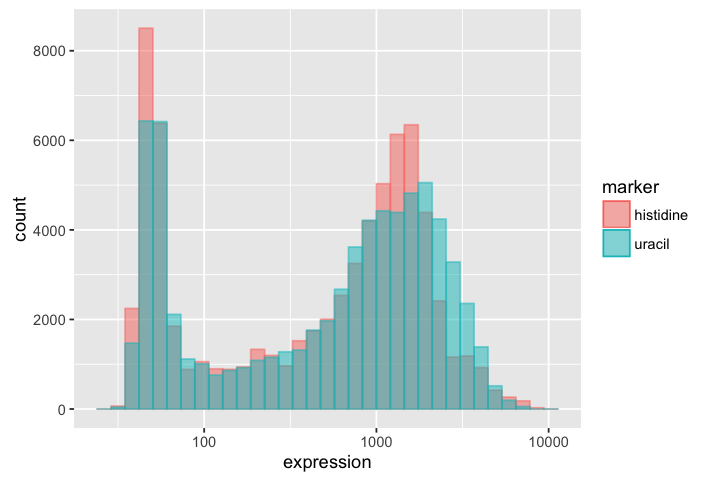

In [11]:
# make a few graphs

# set the size of the graph
options(repr.plot.width=6, repr.plot.height=4)

ggplot(data=all_data_long, aes(x = expression, fill = marker, color = marker)) +
    geom_histogram(position='identity', alpha=0.5) +
    scale_x_log10()

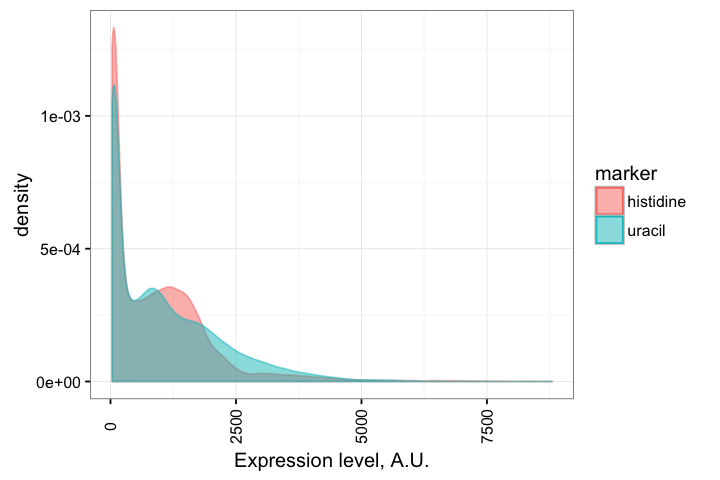

In [12]:
# the graph size will be same as in previous cells unless / until we reset it.

# but say we don't like the "binned" nature of the graph 
#  or the gray background, 
#  or the x-tick look

ggplot(data=all_data_long, aes(x = expression, fill = marker, color=marker)) +
    geom_density(alpha=0.5) +
    theme_bw() +
    theme(axis.text.x = element_text(angle=90, vjust=0.5)) +
    xlab('Expression level, A.U.')

Our data has been combined, but note a problem.  Whether an array corresponds to a "control" or a "treatment" is indicated by the presence of a "C" or a "T" character in the condition string.  But those strings also contain and "H" or a "U" depending on whether the marker was uracil or a histidine.  So even though we might want to compare "C" uracil data vs. "C" histidine data, `R` will not know the two are comparable because the `condition` column as we currently have it is actually recording several independent variables:

* whatever `X251` means (this doesn't vary in this particular data set and is ignored below).
* whether the data corresponds to a treatment T or a control C
* whether the data comes from uracil experiment or histidine experiment.
* the replicate number of a given condition.

An ideal archival form of a data.frame in R has:

* one observation per row (we already did this)
* one factor per column (we haven't done this but it is easy to do)

For various analyses we will need to reshape the data one way or another, but it's always best (in R) **to have the "longest" data possible with the most disaggregated labeling columns possible**.

In [13]:
unique(all_data_long$condition)

[1] "X251UC1" "X251UC2" "X251UC3" "X251UT1" "X251UT2" "X251UT3" "X251UT4"
 [8] "X251HC1" "X251HC2" "X251HC3" "X251HT1" "X251HT2" "X251HT3" "X251HT4"

In [14]:
## need to parse control / trial and replicate number conditions
all_data_long$marker <- as.factor(str_extract(all_data_long$condition, '[HU]'))
all_data_long$group <- as.factor(str_extract(all_data_long$condition, '[TC]'))

## rename the variables from 'C' vs. 'T' and 'U' vs 'H' to words
levels(all_data_long$marker) <- c('histidine', 'uracil')
levels(all_data_long$group) <- c('control', 'treatment')

# get the replicate number, which in this data is the last number before the end of the "word"
all_data_long$replicate_num <- as.numeric(str_extract(all_data_long$condition, '[0-9]$'))

## for extra fun, lets also extract chromosome # and tag location
all_data_long$chromosome <- as.factor(str_extract(all_data_long$Tag, regex('(?<=chr)[0-9]+')))
all_data_long$tag <- as.factor(str_extract(all_data_long$Tag, regex('uptag|downtag')))
levels(all_data_long$tag) <- c('down', 'up')

# now we can get rid of the tag column and rename columns
all_data_long %<>% select(chromosome, ORF, tag, Gene, marker, group, replicate_num, expression) %>% 
                    rename(orf=ORF, gene=Gene)

head(all_data_long)
tail(all_data_long)

,chromosome,orf,tag,gene,marker,group,replicate_num,expression
1,1,YAL002W,up,VPS8,uracil,control,1,3463.229
2,1,YAL004W,up,NA,uracil,control,1,7358.257
3,1,YAL005C,up,SSA1,uracil,control,1,4286.857
4,1,YAL007C,up,ERP2,uracil,control,1,4938.143
5,1,YAL008W,up,FUN14,uracil,control,1,4843.4
6,1,YAL009W,up,SPO7,uracil,control,1,739.3143


,chromosome,orf,tag,gene,marker,group,replicate_num,expression
141913,16,YPR196W,down,NA,histidine,treatment,4,976.9143
141914,16,YPR197C,down,NA,histidine,treatment,4,359.5714
141915,16,YPR198W,down,SGE1,histidine,treatment,4,128.0857
141916,16,YPR199C,down,ARR1,histidine,treatment,4,3415
141917,16,YPR200C,down,ARR2,histidine,treatment,4,47.4
141918,16,YPR201W,down,ARR3,histidine,treatment,4,652.7143


With data in a long format, computing any summary statistics we want is easy with `dplyr`'s `summarize()` function.  First we use `group_by()` to indicate the columns that we do _not_ want collapsed into the summary.  Compare:

In [15]:
# there's so much data, maybe we should average it across replicates

all_data_avg <- all_data_long %>%
                    select(orf, chromosome, tag, gene, marker, group, replicate_num, expression) %>%
                    group_by(orf, chromosome, tag, gene, marker, group) %>%
                    summarize(mean_expression=mean(expression), expression_sd=sd(expression))



for_comparison <- all_data_long %>%
                    select(orf, chromosome, tag, gene, marker, group, replicate_num, expression) %>%
                    # no group by at all
                    summarize(mean_expression=mean(expression), expression_sd=sd(expression))



for_comparison2 <- all_data_long %>%
                    select(orf, chromosome, tag, gene, marker, group, replicate_num, expression) %>%
                    group_by(marker, tag) %>%  # grouping only by marker and tag
                    summarize(mean_expression=mean(expression), expression_sd=sd(expression))

head(all_data_avg)
head(for_comparison)
head(for_comparison2)

,orf,chromosome,tag,gene,marker,group,mean_expression,expression_sd
1,YAL002W,1,up,VPS8,histidine,control,1328.848,123.5178
2,YAL002W,1,up,VPS8,histidine,treatment,5375.2,131.7995
3,YAL002W,1,up,VPS8,uracil,control,3544.143,99.14818
4,YAL002W,1,up,VPS8,uracil,treatment,1650.629,620.5549
5,YAL004W,1,up,NA,histidine,control,8795.971,0
6,YAL004W,1,up,NA,histidine,treatment,8795.971,0


,mean_expression,expression_sd
1,1011.968,1067.864


,marker,tag,mean_expression,expression_sd
1,histidine,down,1078.276,1122.333
2,histidine,up,795.1977,904.0753
3,uracil,down,1216.042,1135.168
4,uracil,up,967.0174,1053.961


The main advantage of the long format is that it is unique (except for the order of columns and rows which R doesn't care about).  There is only one long-format for your data.  But potential "wide" formats vary considerably depending on what analyses you are doing.  For example, the original data had 7 columns across which two things were varying (treatment vs. control, replicate number).  We combined two datasets that represented a separate variable (histidine vs. uracil), but we combined _rows_.  In theory we could have combined columns, so the resulting dataset would have 14 columns of observations.  But think about some of the comparisons we _could_ do:

* histidine vs. uracil: the ideal "wide" format would be two columns wide.
* treatment vs. control, combining both histidine and uracil data into a single average: the ideal wide format would also be _two_ columns wide, but they would be different than above.
* treatment vs. control, histidine vs. uracil simultaneously: this would be _four_ columns "wide".
* if replicates were "paired" across histidine / uracil: these data represent independent microarrays, and the labels of replicate 1, 2, 3 etc. are arbitrary.  Replicate "1" from a control group uracil experiment has nothing in common with replicate "1" from a treatment group histidine experiment.  But that isn't true for some experiments, where the replicates are "paired".  If you wanted to get a summary of this type of paired data across replicates, the desired number of columns would be $n$, where $n$ is the number of replicates.  
* treatment vs. control unaggregated for replicates.  This is is the "wide" format that we started with.  


It's hopefully clear that if you have a "wide" data format, it is just one of many possible "wide" formats for your data.  But there is only one way to write your data in a "long" format, with one observation per row.  The primary advantage of the long format is that it's easy to reshape to any wide format that your heart desires with `tidyr` and `dplyr`.  Here we use the `spread()` function from `tidyr`.

,orf,chromosome,tag,gene,group,histidine,uracil
1,YAL002W,1,up,VPS8,control,1328.848,3544.143
2,YAL002W,1,up,VPS8,treatment,5375.2,1650.629
3,YAL004W,1,up,NA,control,8795.971,7239.333
4,YAL004W,1,up,NA,treatment,8795.971,4117.986
5,YAL005C,1,up,SSA1,control,1980.638,4346.6
6,YAL005C,1,up,SSA1,treatment,5376.664,2614.6


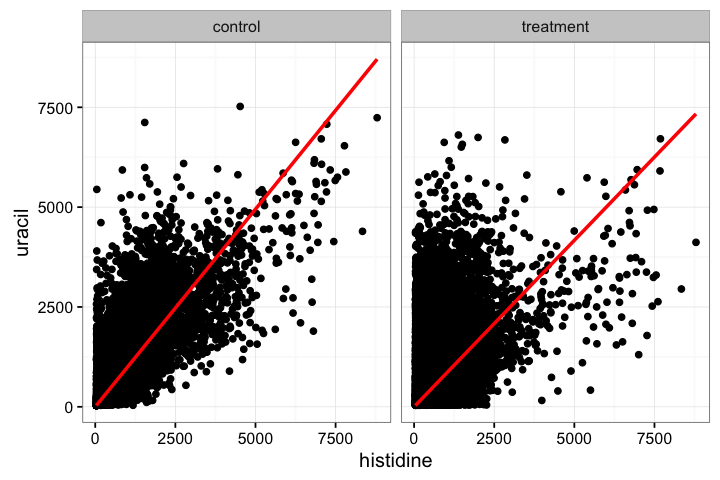

In [16]:
# to compare two classes of expression data, e.g. histidine vs. uracil, we need to widen the data

all_data_paired <- all_data_avg %>% 
                    select(-expression_sd) %>%
                    spread(marker, mean_expression)

head(all_data_paired)

# now graphing histidine vs. uracil is easy
ggplot(data=all_data_paired, aes(x=histidine, y=uracil)) + 
    geom_point() + 
    facet_grid(.~group) + 
    stat_smooth(method='lm', formula = y~x-1, se=F, color='red') +
    theme_bw()

In [17]:
# viewing the model fit

my.model <- lm(data=all_data_paired, formula=uracil~histidine:group-1)
summary(my.model)


Call:
lm(formula = uracil ~ histidine:group - 1, data = all_data_paired)

Residuals:
    Min      1Q  Median      3Q     Max 
-4842.8  -188.8    20.9   538.5  5838.6 

Coefficients:
                         Estimate Std. Error t value Pr(>|t|)    
histidine:groupcontrol   0.989702   0.006502   152.2   <2e-16 ***
histidine:grouptreatment 0.833818   0.007122   117.1   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 903.2 on 19920 degrees of freedom
Multiple R-squared:  0.6493,	Adjusted R-squared:  0.6492 
F-statistic: 1.844e+04 on 2 and 19920 DF,  p-value: < 2.2e-16


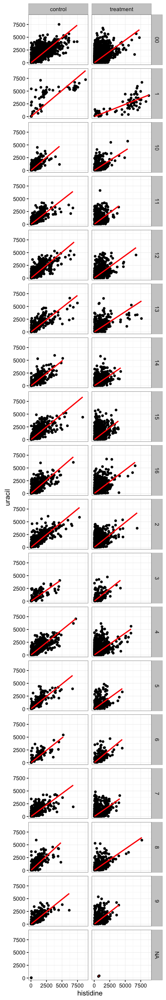

In [18]:
options(repr.plot.width=4, repr.plot.height=24)

ggplot(data=all_data_paired, aes(x=histidine, y=uracil)) + 
    geom_point() + 
    facet_grid(chromosome~group) + 
    stat_smooth(method='lm', formula = y~x-1, se=F, color='red') +
    theme_bw()


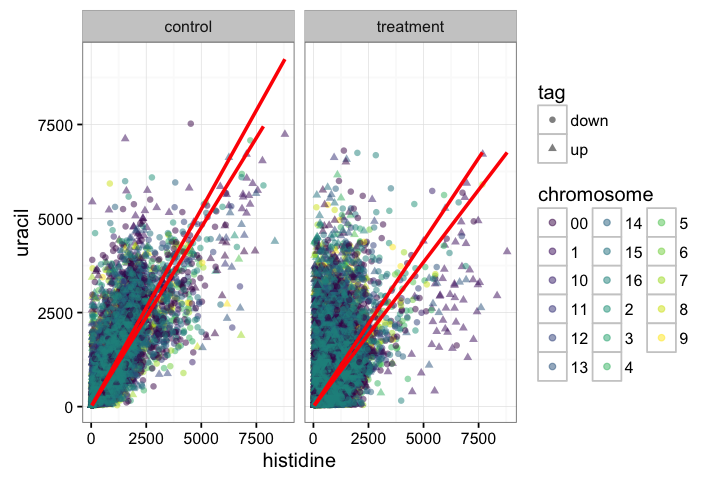

In [19]:
# color instead of facets
options(repr.plot.width=6, repr.plot.height=4)

ggplot(data=all_data_paired, aes(x=histidine, y=uracil, color=chromosome, shape=tag)) + 
    geom_point(alpha=0.5) + 
    facet_grid(.~group) + 
    stat_smooth(method='lm', formula = y~x-1, se=F, color='red') +
    theme_bw() +
    scale_color_viridis(discrete=T, guide=guide_legend(ncol=3))

In [20]:
# function from Stack Overflow for doing t.tests with dplyr
# http://stackoverflow.com/a/29150284/4480692

my.t.test <- function(data, formula, ...){
    # do t test
    tt <- t.test(formula=formula, data=data, ...)
    
    ests <- tt$estimate
    names(ests) <- sub("mean in group ()", "\\1", names(ests))
    counts <- xtabs(formula[c(1, 3)], data)
    names(counts) <- paste0("n", names(counts))
    cbind(
          as.list(ests),
          data.frame(
            CI = paste0("(", paste(tt$conf.int, collapse=", "), ")"),
            pvalue = tt$p.value,
            stringsAsFactors=FALSE
            ),
          as.list(counts)
    )
}

In [21]:
# doing t-tests on long-formatted data: crashes because of "bad" data

all_data_t <- all_data_long %>% 
        group_by(orf, chromosome, tag, gene, marker) %>%
        do(my.t.test(., expression ~ group))

ERROR: Error in t.test.default(x = c(8795.97142857143, 8795.97142857143, 8795.97142857143: data are essentially constant


In [ ]:
# doing t-tests on long-formatted data: removing bad data
all_data_t <- all_data_long %>% 
        group_by(orf, chromosome, tag, gene, marker) %>%
        filter(expression != 8795.97142857143) %>%
        do(my.t.test(., expression ~ group)) %>%
        ungroup() %>%
        arrange(pvalue)

In [ ]:
head(all_data_t, 10) 

In [ ]:
ggplot(data=all_data_t, aes(x=log2(treatment / control), y=-log10(pvalue))) + 
    geom_point() + 
    theme_bw() +
    xlab(expression(log[2] * bgroup('(', 
                                 frac('treatment', 'control'), 
                                ')')
                   )
        ) +
    ylab(expression(-log[10] * 'p'))